In [2]:
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt
from albcovis.utils.img import pil_to_numpy01, rgb_to_gray


In [3]:
dir = Path("../data/source/images")
imgs_filenames = [
    "40654268451-px_500.jpg", # 10000Hz Legend
    "14688551481-large.jpg", # MKWAJU
    "9845751214-large.jpg", # Gotan Project
    "22280981189-px_500.jpg", # Dick's Picks Volume Four
    "11446625684-large.jpg", # Carnaval
    "24818281700-px_500.jpg", # Tiger Army Retrofuture
    "39341710398-px_500.jpg", # Xerrox
    "3880053972-px_500.jpg", # Unknown Pleasures
    "24961543145-px_500.jpg", # Hats
    "23776122656-px_500.jpg", # Tre
    "1766939079-large.jpg", # Richest man in babylon
    "17519297659-px_500.jpg", # Amor amarillo
    "4924862361-large.jpg", # The White Album
    "30944412549-px_500.jpg" # Donda
    ] 

In [4]:
from skimage.feature._canny_cy import _nonmaximum_suppression_bilinear as _nms_bilinear

# Edge density & Orientation entropy

## Understanding the process of canny edge detection

Using code by Sofiane Sahir as published in an article in Towards Data Science in 2019 ([link](https://medium.com/data-science/canny-edge-detection-step-by-step-in-python-computer-vision-b49c3a2d8123)).


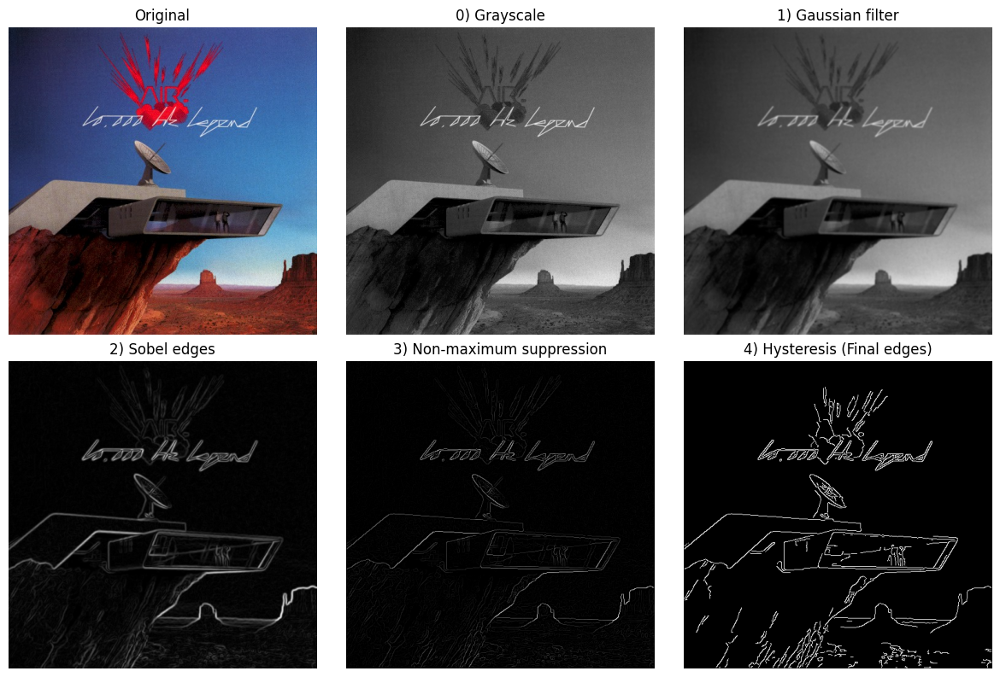

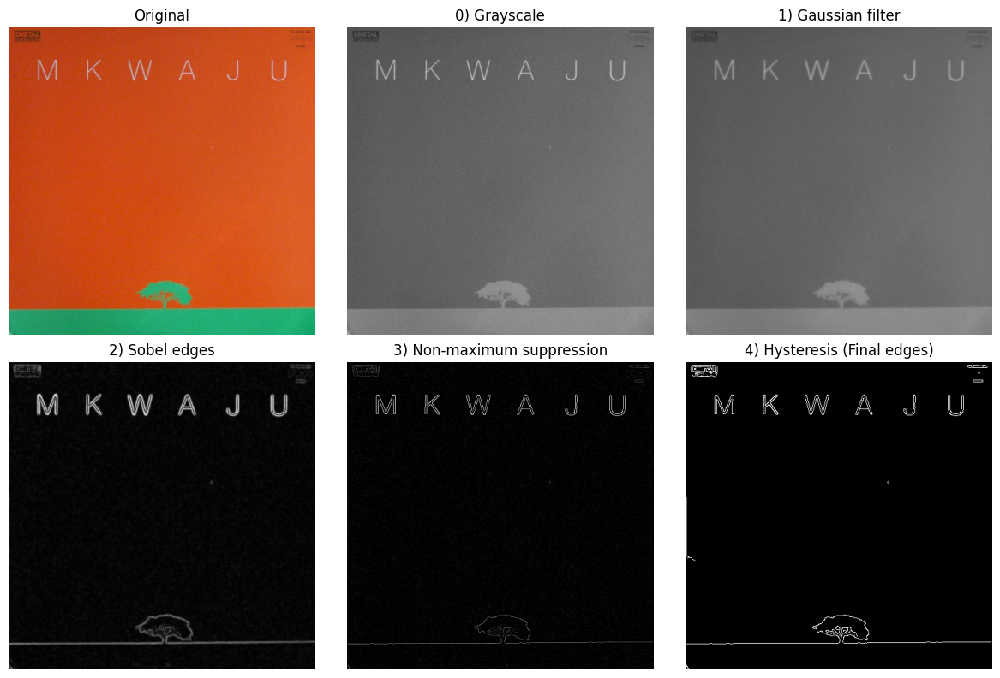

In [5]:
import numpy as np
from scipy.ndimage import convolve

# Import slightly adapted functions from reference article to understand steps

def gaussian_kernel(size: int, sigma: float = 1.4) -> np.ndarray:
    half = int(size) // 2
    y, x = np.mgrid[-half:half+1, -half:half+1]
    normal = 1.0 / (2.0 * np.pi * sigma**2)
    g = np.exp(-((x**2 + y**2) / (2.0 * sigma**2))) * normal
    return g.astype(np.float32)

def sobel_filters(img: np.ndarray):
    Kx = np.array([[-1, 0, 1],
                   [-2, 0, 2],
                   [-1, 0, 1]], dtype=np.float32)
    Ky = np.array([[ 1,  2,  1],
                   [ 0,  0,  0],
                   [-1, -2, -1]], dtype=np.float32)

    Ix = convolve(img, Kx, mode="reflect")
    Iy = convolve(img, Ky, mode="reflect")

    G = np.hypot(Ix, Iy).astype(np.float32)
    G = (G / (G.max() + 1e-8) * 255.0).astype(np.float32)  # match repo scaling
    theta = np.arctan2(Iy, Ix).astype(np.float32)
    return G, theta

def non_max_suppression(mag: np.ndarray, angles: np.ndarray) -> np.ndarray:
    """
    Thin edges by suppressing non-maxima along the local gradient direction.
    Expects:
      - mag: gradient magnitude (float array)
      - angles: gradient orientation in radians, same shape as mag
    Returns:
      - nms: thinned magnitude map (float32), zeros where suppressed
    """

    nms = np.zeros_like(mag, dtype=np.float32)  # output initialized to zero (suppressed everywhere)
    angle = (np.degrees(angles) % 180.0).astype(np.float32)  # convert radians -> degrees and wrap to [0,180)

    H, W = mag.shape  # image size (rows, cols)

    # loop over interior pixels (borders are skipped because they lack two neighbors)
    for i in range(1, H - 1):  # rows 1..H-2
        for j in range(1, W - 1):  # cols 1..W-2
            a = angle[i, j]  # local orientation in degrees
            m = mag[i, j]    # local magnitude

            # pick the two neighbors to compare with, aligned with the quantized direction
            # four bins: 0°, 45°, 90°, 135°
            if (0.0 <= a < 22.5) or (157.5 <= a <= 180.0):
                q = mag[i, j + 1]   # neighbor in +x
                r = mag[i, j - 1]   # neighbor in -x
            elif (22.5 <= a < 67.5):
                q = mag[i + 1, j - 1]  # neighbor at +45° (down-left)
                r = mag[i - 1, j + 1]  # neighbor at -135° (up-right)
            elif (67.5 <= a < 112.5):
                q = mag[i + 1, j]   # neighbor in +y
                r = mag[i - 1, j]   # neighbor in -y
            else:  # (112.5 <= a < 157.5)
                q = mag[i - 1, j - 1]  # neighbor at -45° (up-left)
                r = mag[i + 1, j + 1]  # neighbor at +135° (down-right)

            # keep a pixel only if it is a local maximum along the gradient direction
            if (m >= q) and (m >= r):
                nms[i, j] = m       # keep the magnitude (unsuppressed)
            # else: leave as 0 (suppressed)

    return nms
    
def threshold(img: np.ndarray, lowThresholdRatio: float = 0.05, highThresholdRatio: float = 0.15):
    highThreshold = img.max() * highThresholdRatio
    lowThreshold  = highThreshold * lowThresholdRatio

    res = np.zeros(img.shape, dtype=np.int32)
    weak, strong = np.int32(75), np.int32(255)

    strong_i, strong_j = np.where(img >= highThreshold)
    weak_i,   weak_j   = np.where((img <= highThreshold) & (img >= lowThreshold))

    res[strong_i, strong_j] = strong
    res[weak_i,   weak_j]   = weak
    return res, weak, strong

def hysteresis(img: np.ndarray, weak: int, strong: int = 255) -> np.ndarray:
    M, N = img.shape
    out = img.copy()
    for i in range(1, M-1):
        for j in range(1, N-1):
            if out[i, j] == weak:
                if ((out[i+1, j-1] == strong) or (out[i+1, j] == strong) or (out[i+1, j+1] == strong) or
                    (out[i,   j-1] == strong) or                             (out[i,   j+1] == strong) or
                    (out[i-1, j-1] == strong) or (out[i-1, j] == strong) or (out[i-1, j+1] == strong)):
                    out[i, j] = strong
                else:
                    out[i, j] = 0
    return out

# Loop over somedev_set images to show steps of canny edge detector (raw implementation)
for filename in imgs_filenames[:2]:
    path = dir / filename
    img = Image.open(path)

    # 0) Grayscale
    rgb01 = pil_to_numpy01(img)
    gray01 = rgb_to_gray(rgb01)

    # 1) Gaussian filter (repo-style)
    kernel = gaussian_kernel(size=5, sigma=1.0)         # same defaults as the article
    smoothed = convolve(gray01.astype(np.float32), kernel, mode="reflect")

    # 2) Sobel gradients (repo-style normalization to 0..255)
    mag_255, angles = sobel_filters(smoothed)
    thr = np.percentile(mag_255, 90)
    sobel_edges = mag_255 > thr

    # 3) Non-maximum suppression
    nms = non_max_suppression(mag_255, angles)

    # 4) Double threshold + hysteresis (repo-style, integer labels)
    labels, WEAK, STRONG = threshold(nms, lowThresholdRatio=0.05, highThresholdRatio=0.15)
    final_edges_u8 = hysteresis(labels, WEAK, STRONG)   # values in {0, 75, 255}
    final_edges_bool = (final_edges_u8 == STRONG)       # convenient for overlay/plotting


    # Show
    fig, axes = plt.subplots(2, 3, figsize=(12, 8))
    ax1,ax2,ax3,ax4,ax5,ax6 = axes.ravel()

    ax1.imshow(img)
    ax1.set_title("Original")
    ax1.axis("off")

    ax2.imshow(gray01, cmap="gray", vmin=0, vmax=1)
    ax2.set_title("0) Grayscale")
    ax2.axis("off")

    ax3.imshow(smoothed, cmap="gray", vmin=0, vmax=1)
    ax3.set_title("1) Gaussian filter")
    ax3.axis("off")

    ax4.imshow(mag_255, cmap="gray", vmin=0, vmax=255)
    ax4.set_title(f"2) Sobel edges")
    ax4.axis("off")

    ax5.imshow(nms, cmap="gray", vmin=0, vmax=255)
    ax5.set_title("3) Non-maximum suppression")
    ax5.axis("off")

    ax6.imshow(final_edges_bool, cmap="gray")
    ax6.set_title("4) Hysteresis (Final edges)")
    ax6.axis("off")

    plt.tight_layout()
    plt.show()


## Testing different methods to define thresholds

When talking about thresholds for canny algorithm we mean the thresholds used in the hystereis step (final one) to decide the final and definitive edges. These thresholds are used to label pixels as "strong", "weak" or "low" edges. trong edges are definitive edges in the out put of the algorith, weak edges will pass trhough hysteresis step to define them as final edges or not depending on if they are close to strong edges, and low edges are discarded.

So thresholds are in the scale of the magnitude, in this case we use [0,1] scale.

In order to resolve the challenges where it is hard to determine the dual-threshold value empirically, Otsu's method can be used on the non-maximum suppressed gradient magnitude image to generate the high threshold. Some implementations apply it on the raw grayscale intensities, and others normally apply it on the gradient magnitudes array or the gradient magnitude array after non maximum suppresion step in canny algorithm. The challenge is skimage doesn't expose the intermediate arrays of the canny algorithm steps. So to use Otsu to compute thresholds in a **data-driven and empirical** way, we must approximate/mimic the intermediate steps (gaussian filter, sobel operators for magnitudes and orientations and non maximum suppresion). In the original paper by Canny he states guidance to keep a high:low ratio around 2:1 to 3:1, and that is taken into account.

`skimage`'s default is a 0.1 low threshold and 0.2 high threshold. `skimage` can use use quantiles on the gradient magnitudes array.

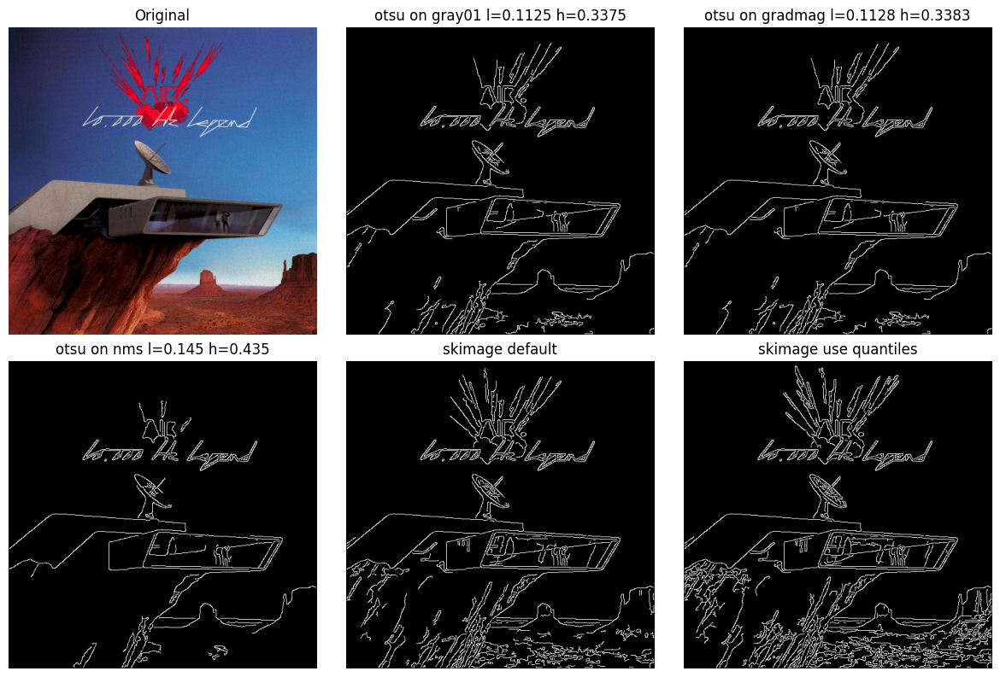

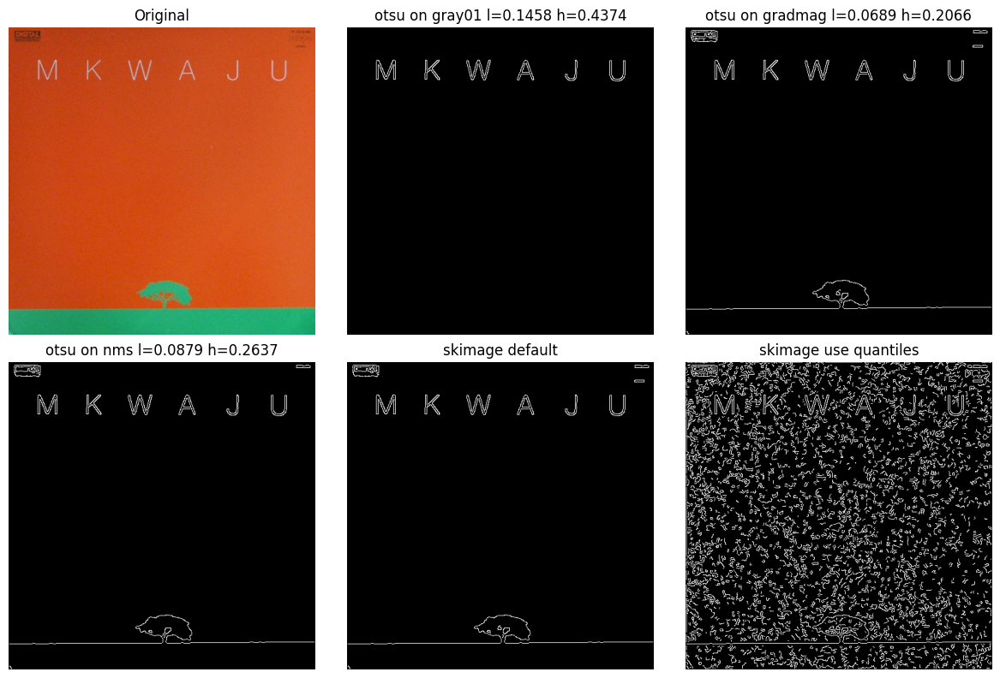

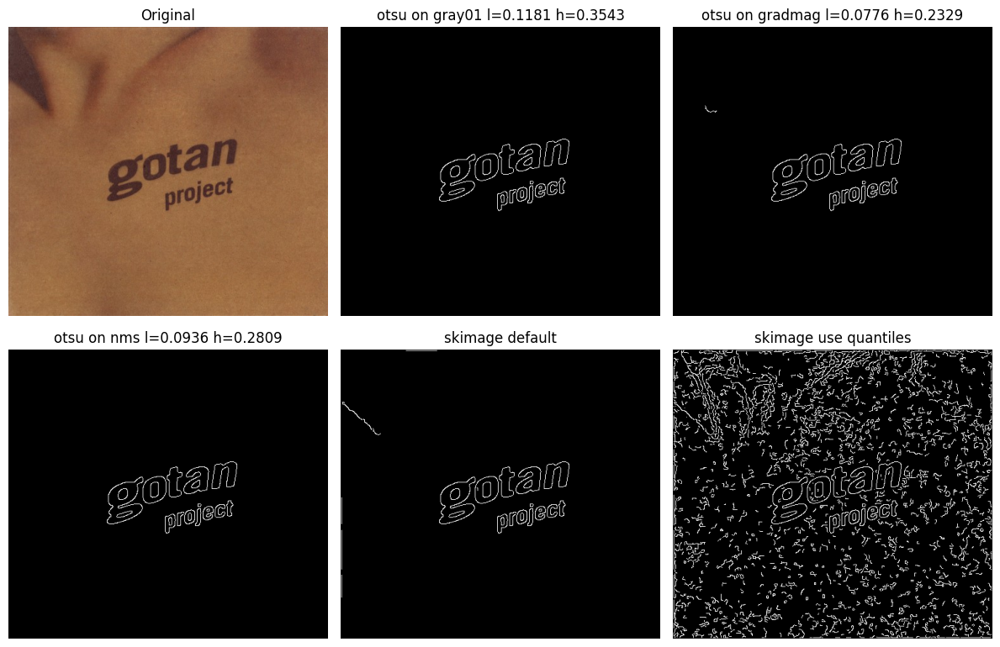

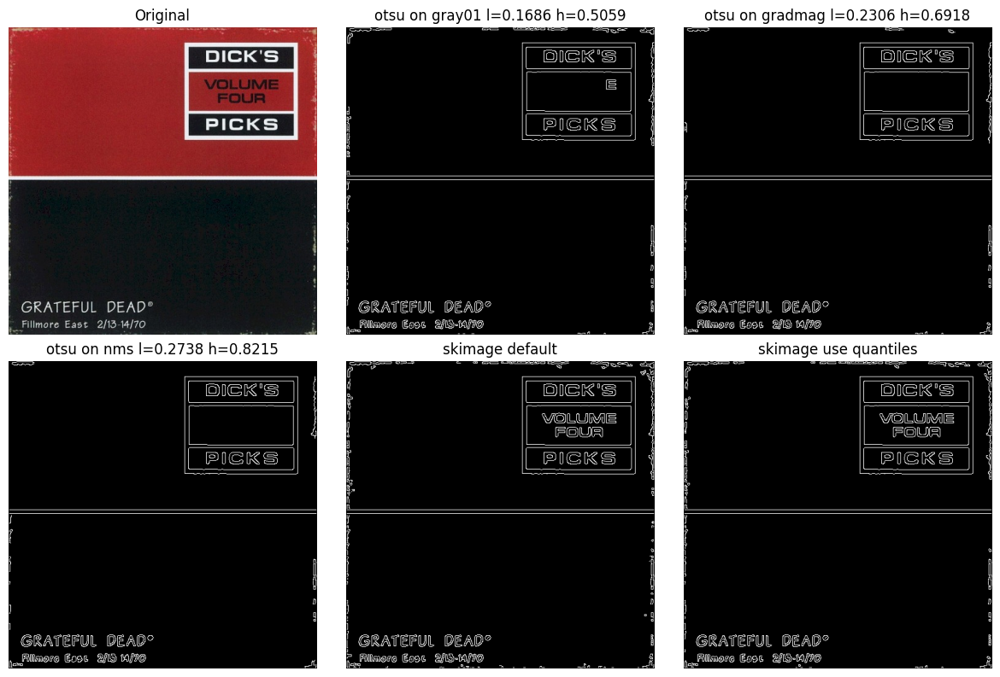

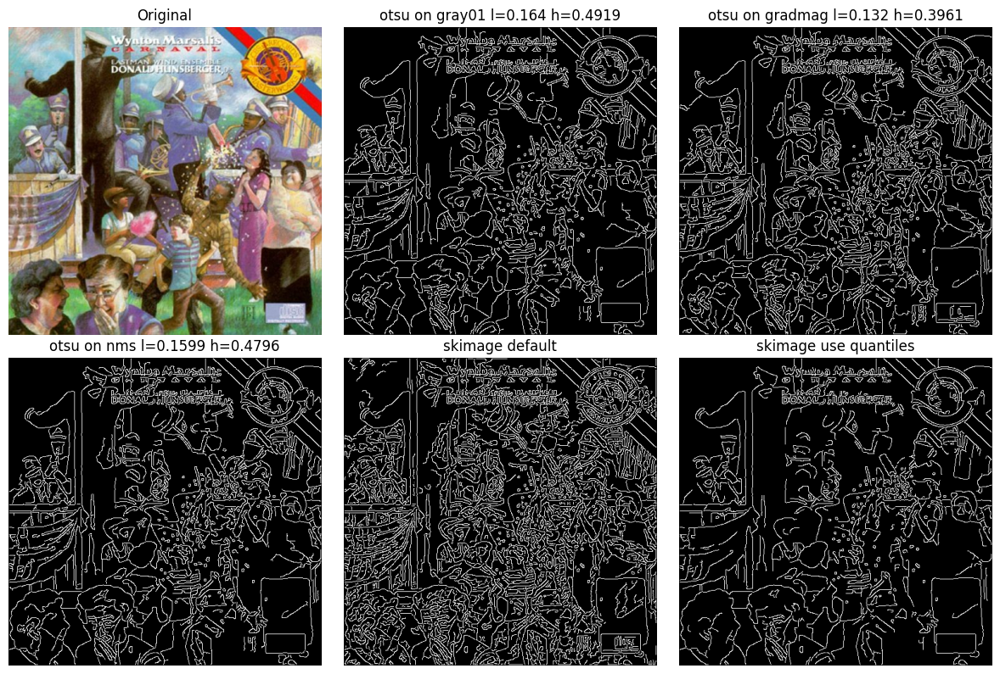

...

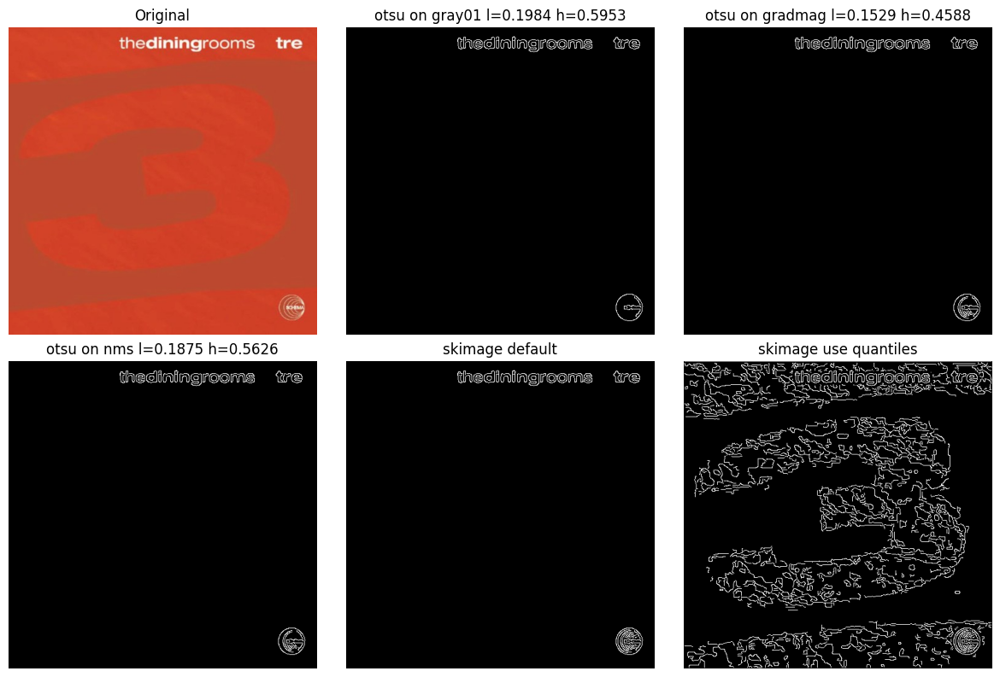

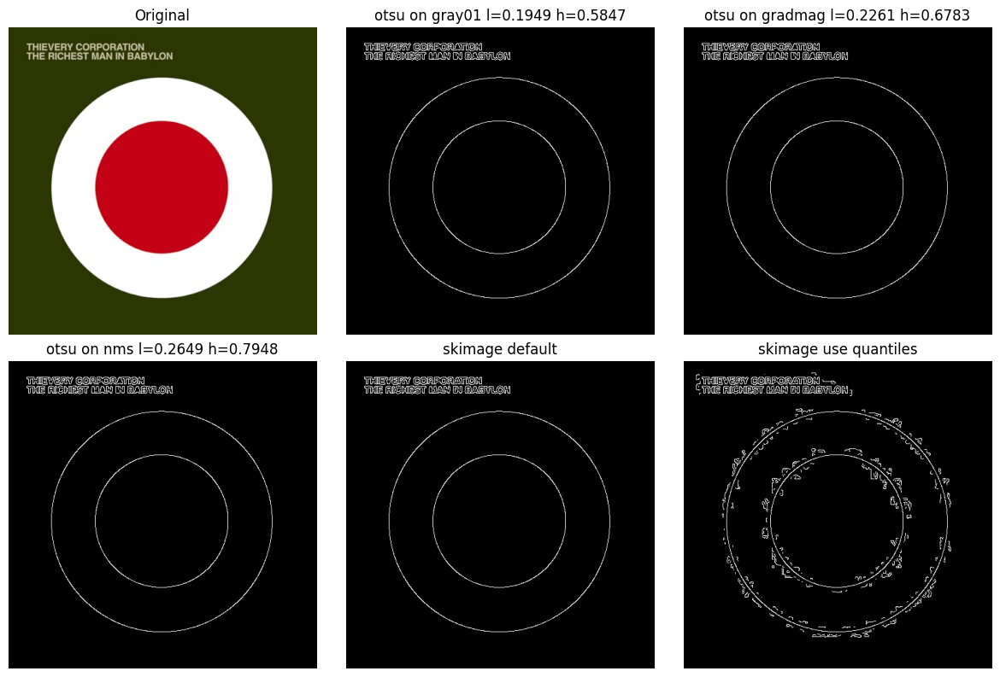

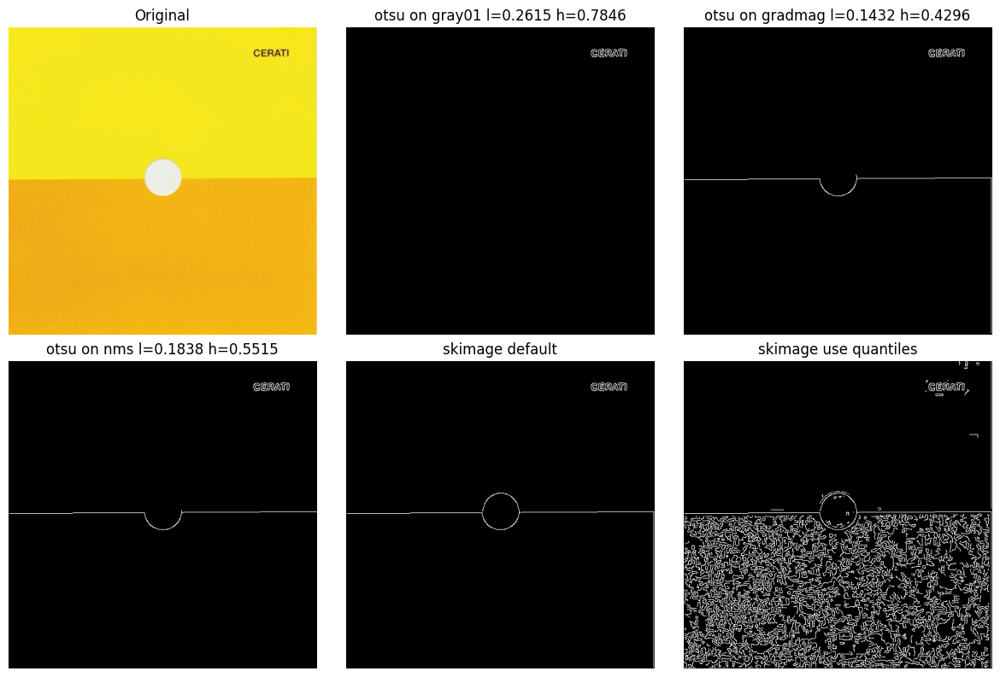

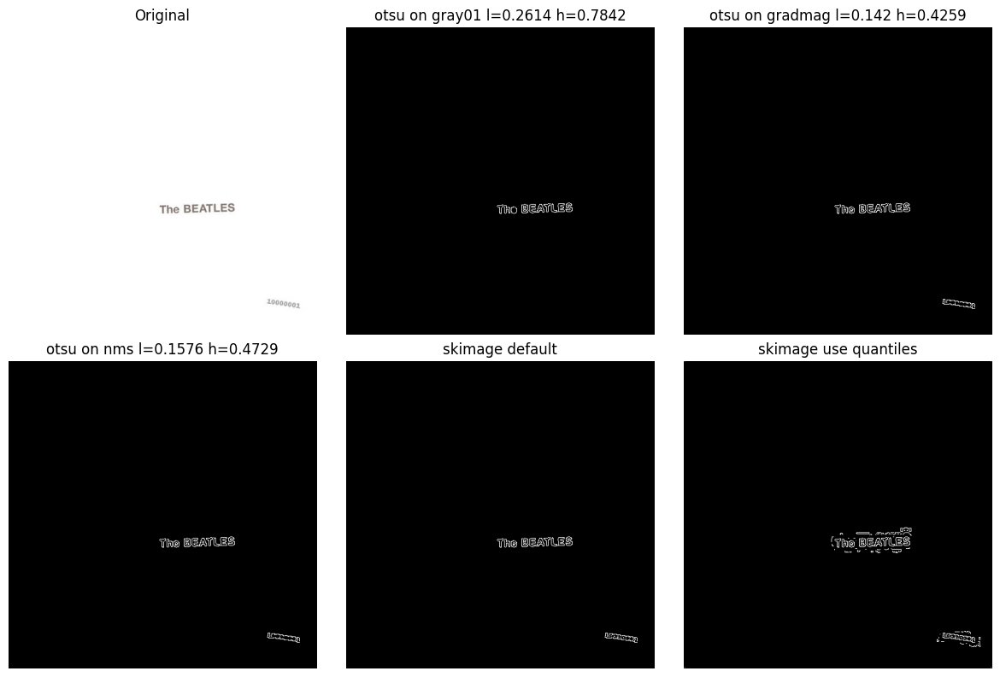

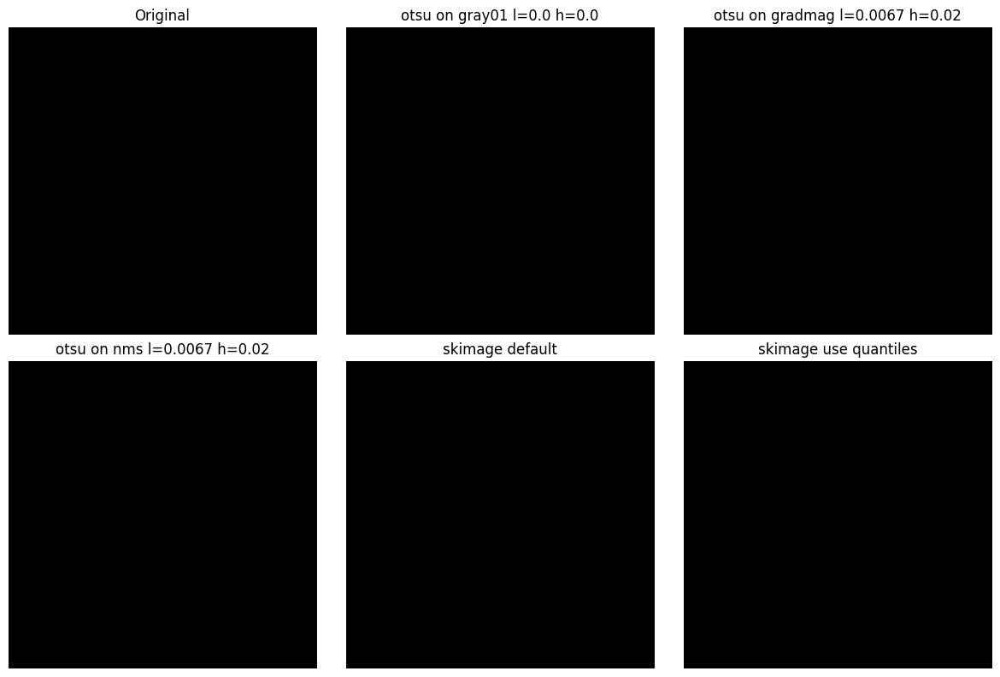

In [6]:
from albcovis.utils.img import pil_to_numpy01, rgb_to_gray
from albcovis.services.texture_descriptors import compute_canny_edges, compute_sobel_gradients, edge_density, orientation_entropy_from_sobel
from skimage import feature

from albcovis.services.texture_descriptors import canny_thresholds_otsu_on_gray, canny_thresholds_otsu_on_gradmag, canny_thresholds_otsu_on_nms

# Loop over some dev_set images to show our implementation of canny edge detector for this project

for filename in imgs_filenames:
    fig, axes = plt.subplots(2, 3, figsize=(12, 8))
    ax1,ax2,ax3,ax4,ax5,ax6 = axes.ravel()

    path = dir / filename
    img = Image.open(path)
    ax1.imshow(img)
    ax1.set_title("Original")
    ax1.axis("off")


    # prepocess
    rgb01 = pil_to_numpy01(img)
    gray01 = rgb_to_gray(rgb01)

    # otsu on grayscale intensities
    low, high, info = canny_thresholds_otsu_on_gray(gray01)
    edges = feature.canny(gray01, sigma=1.0, low_threshold=low, high_threshold=high)
    ax2.imshow(edges, cmap="gray")
    ax2.set_title(f"otsu on gray01 l={round(low, 4)} h={round(high, 4)}")
    ax2.axis("off")

    # otsu on gradmag
    low, high, info = canny_thresholds_otsu_on_gradmag(gray01)
    edges = feature.canny(gray01, sigma=1.0, low_threshold=low, high_threshold=high)
    ax3.imshow(edges, cmap="gray")
    ax3.set_title(f"otsu on gradmag l={round(low, 4)} h={round(high, 4)}")
    ax3.axis("off")

    # otsu on nms
    low, high, info = canny_thresholds_otsu_on_nms(gray01)
    edges = feature.canny(gray01, sigma=1.0, low_threshold=low, high_threshold=high)
    ax4.imshow(edges, cmap="gray")
    ax4.set_title(f"otsu on nms l={round(low, 4)} h={round(high, 4)}")
    ax4.axis("off")

    # skimage default
    edges = feature.canny(gray01, sigma=1.0, low_threshold=None, high_threshold=None)
    ax5.imshow(edges, cmap="gray")
    ax5.set_title(f"skimage default")
    ax5.axis("off")

    # skimage use quantiles
    edges = feature.canny(gray01, sigma=1.0, low_threshold=0.70, high_threshold=0.90, use_quantiles=True)
    ax6.imshow(edges, cmap="gray")
    ax6.set_title(f"skimage use quantiles")
    ax6.axis("off")

    plt.tight_layout()
    plt.show()

## Testing different sigmas for gaussian filter

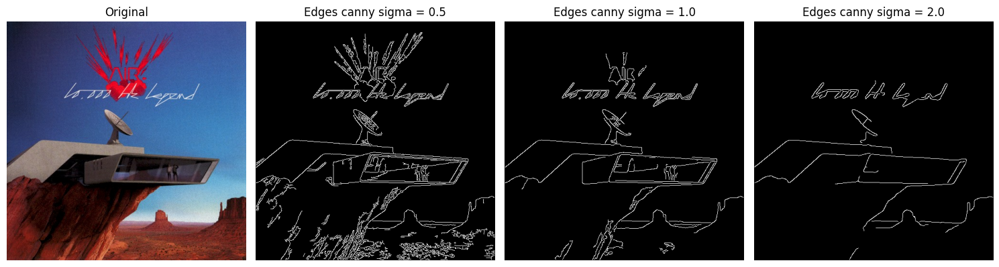

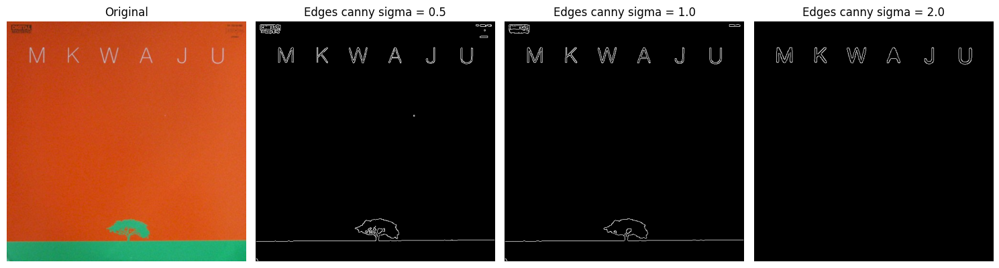

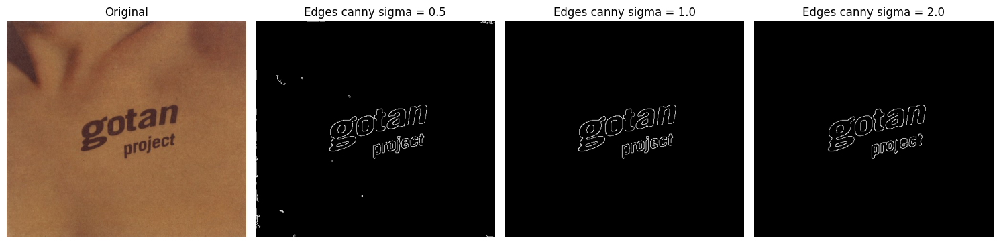

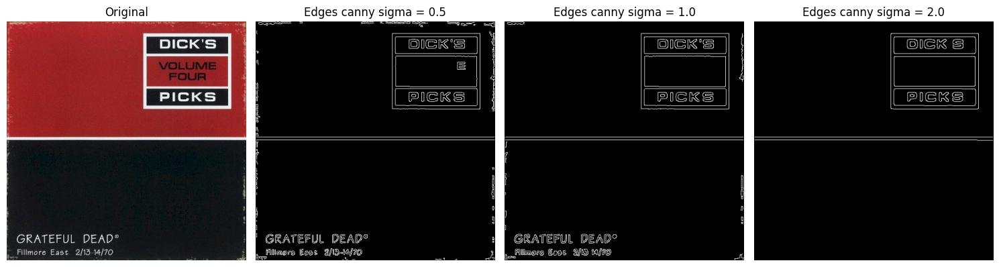

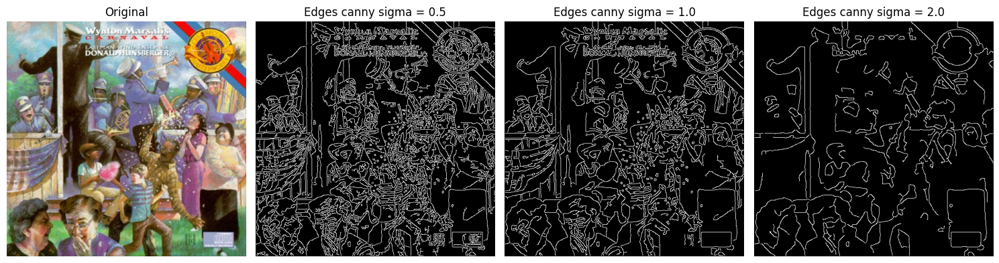

...

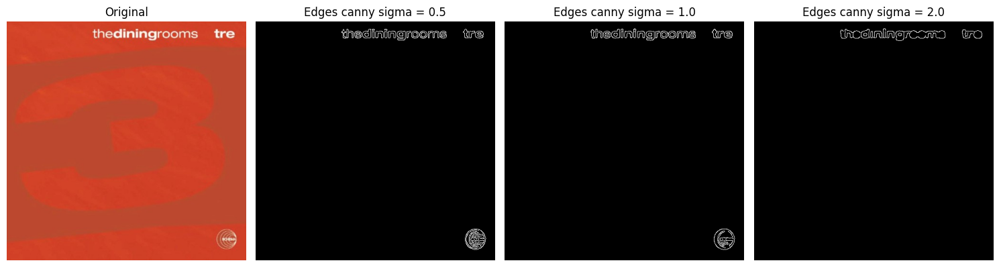

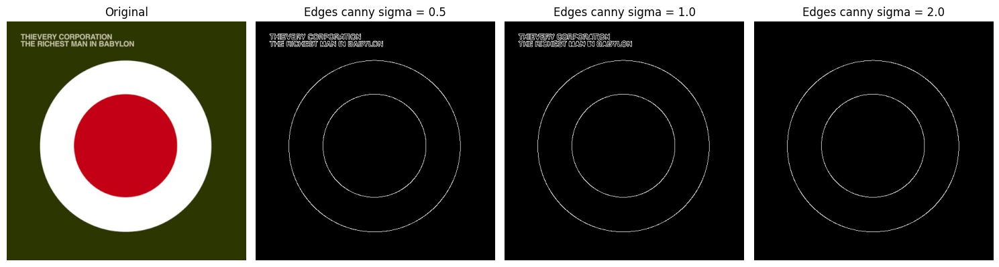

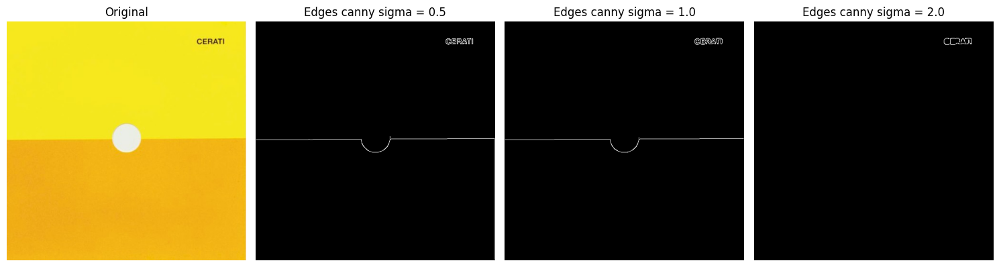

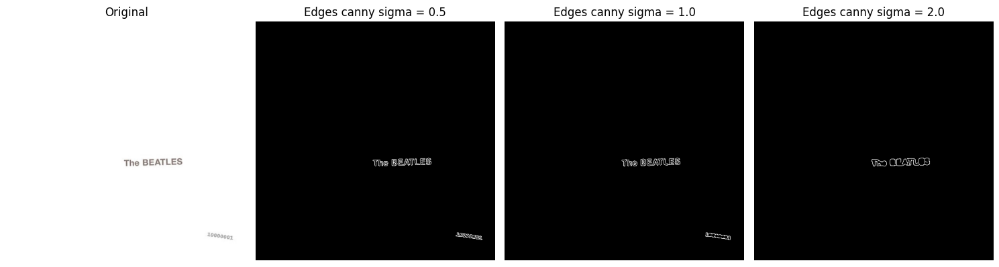

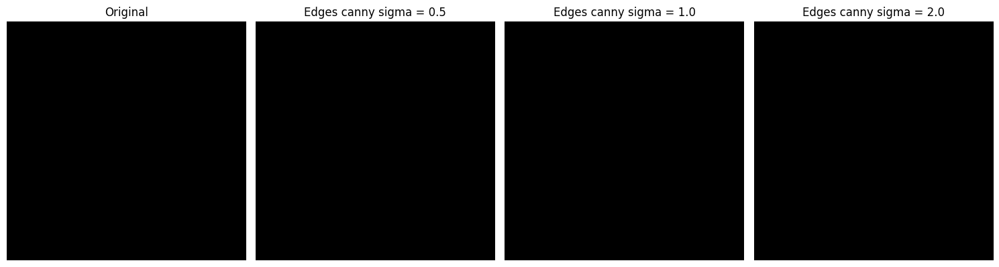

In [7]:
from albcovis.utils.img import pil_to_numpy01, rgb_to_gray
from albcovis.services.texture_descriptors import compute_canny_edges

# Loop over some dev_set images to show our implementation of canny edge detector for this project

for filename in imgs_filenames:
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(15, 4))

    path = dir / filename
    img = Image.open(path)

    ax1.imshow(img)
    ax1.set_title("Original")
    ax1.axis("off")

    rgb01 = pil_to_numpy01(img)
    gray01 = rgb_to_gray(rgb01)

    sigma = 0.5
    edges = compute_canny_edges(gray01, sigma=sigma)
    ax2.imshow(edges, cmap="gray", vmin=0, vmax=1)
    ax2.set_title(f"Edges canny sigma = {sigma}")
    ax2.axis("off")

    sigma = 1.0
    # low, high, info = canny_thresholds_otsu_on_nms(gray01)
    # edges = feature.canny(gray01, sigma=sigma)
    edges = compute_canny_edges(gray01, sigma=sigma)
    ax3.imshow(edges, cmap="gray", vmin=0, vmax=1)
    ax3.set_title(f"Edges canny sigma = {sigma}")
    ax3.axis("off")

    sigma = 2.0
    edges = compute_canny_edges(gray01, sigma=sigma)
    ax4.imshow(edges, cmap="gray", vmin=0, vmax=1)
    ax4.set_title(f"Edges canny sigma = {sigma}")
    ax4.axis("off")

    plt.tight_layout()
    plt.show()


## Testing our final implementation for metrics

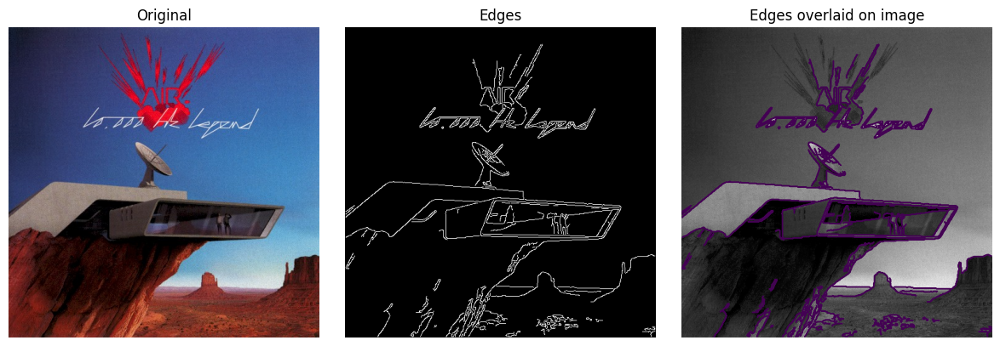

40654268451-px_500.jpg
edge_density: 0.035404
edge_orientation_entropy: 0.95025173360843


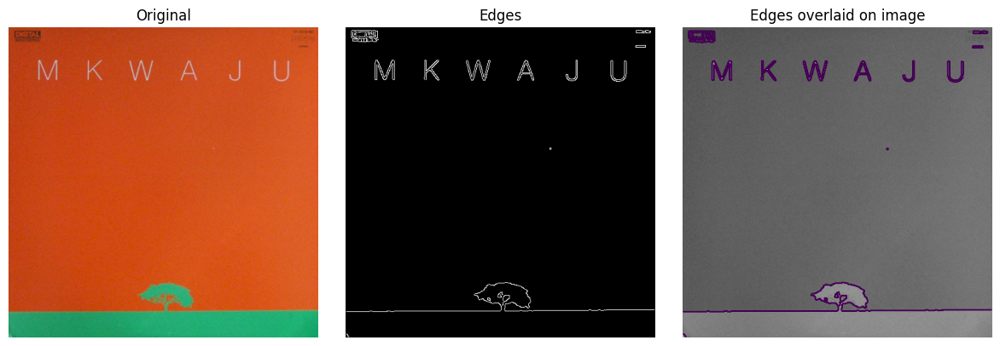

14688551481-large.jpg
edge_density: 0.00968273092369478
edge_orientation_entropy: 0.9572300267973277


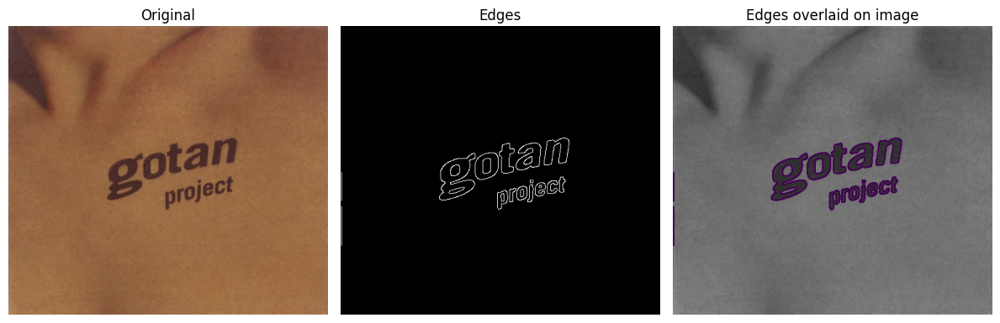

9845751214-large.jpg
edge_density: 0.008845132743362832
edge_orientation_entropy: 0.9830463823299476


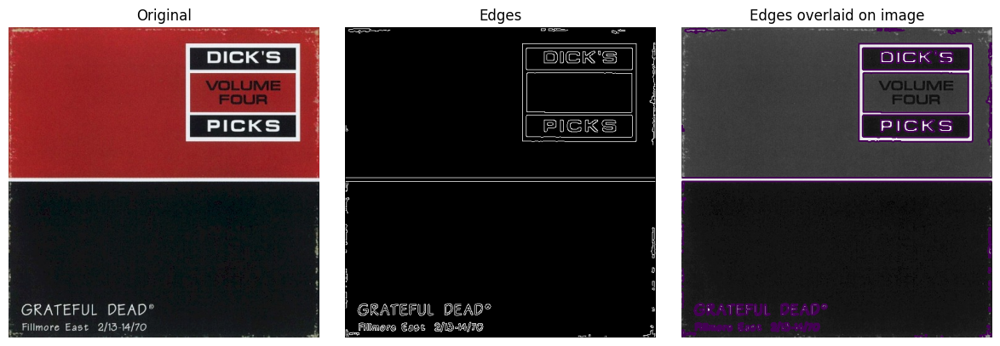

22280981189-px_500.jpg
edge_density: 0.027896
edge_orientation_entropy: 0.787579587421295


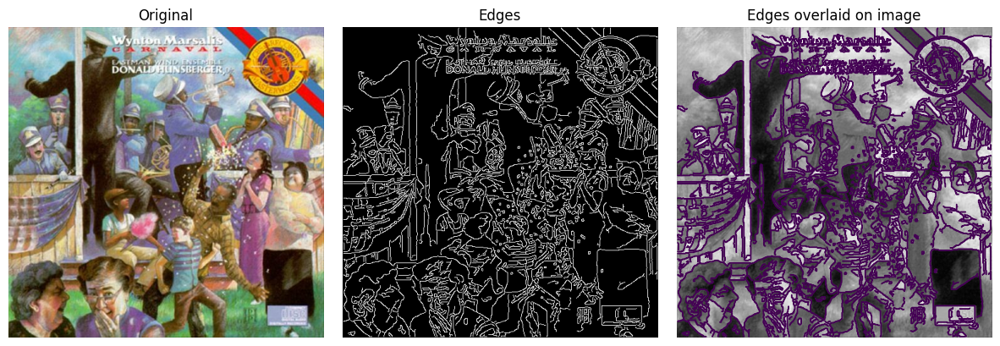

11446625684-large.jpg
edge_density: 0.1423083164300203
edge_orientation_entropy: 0.9865488602225435


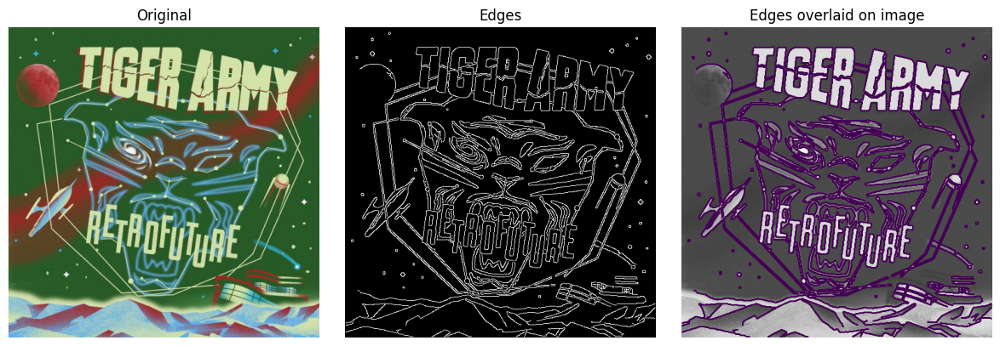

24818281700-px_500.jpg
edge_density: 0.094432
edge_orientation_entropy: 0.952259328519514


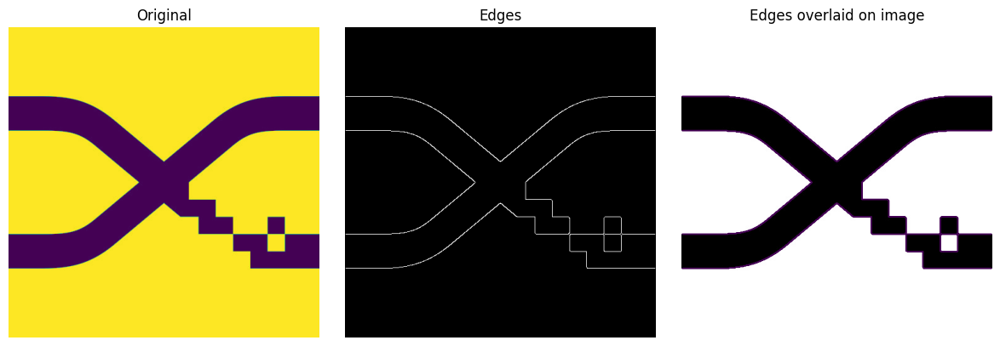

39341710398-px_500.jpg
edge_density: 0.010564
edge_orientation_entropy: 0.7060295678373029


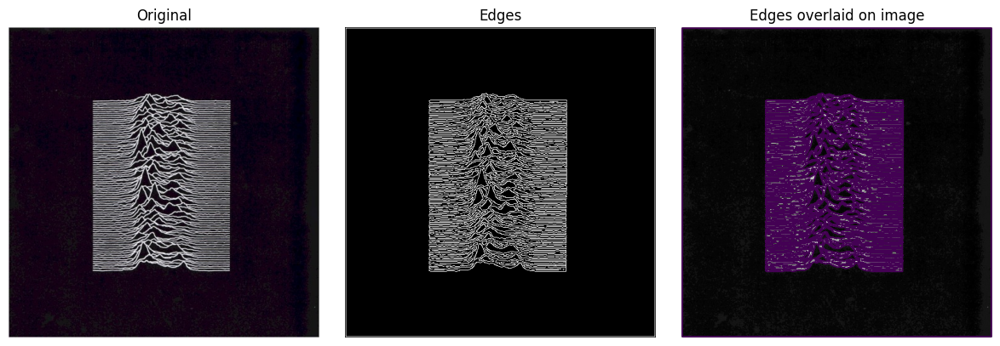

3880053972-px_500.jpg
edge_density: 0.097048
edge_orientation_entropy: 0.7180377363574946


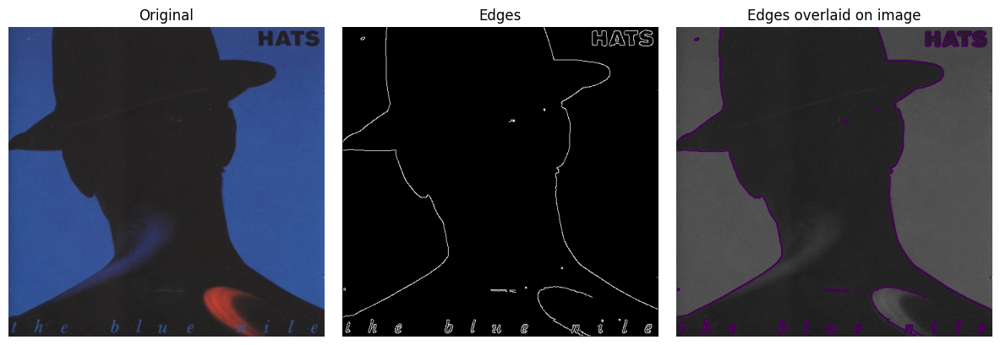

24961543145-px_500.jpg
edge_density: 0.01283739837398374
edge_orientation_entropy: 0.9902144942446431


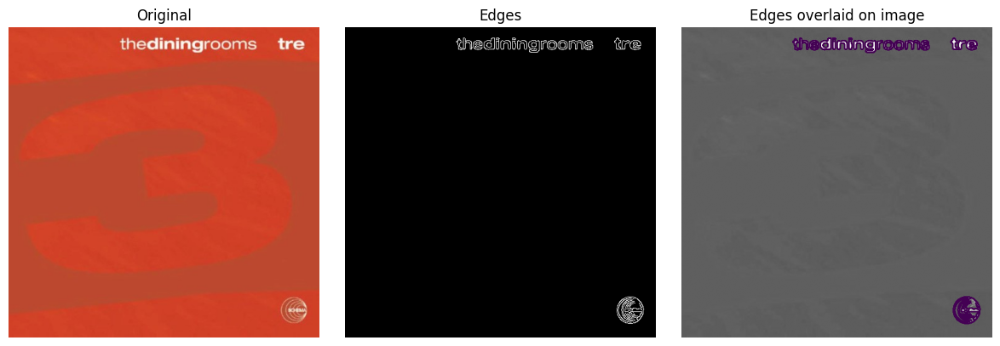

23776122656-px_500.jpg
edge_density: 0.007612
edge_orientation_entropy: 0.9601302486562387


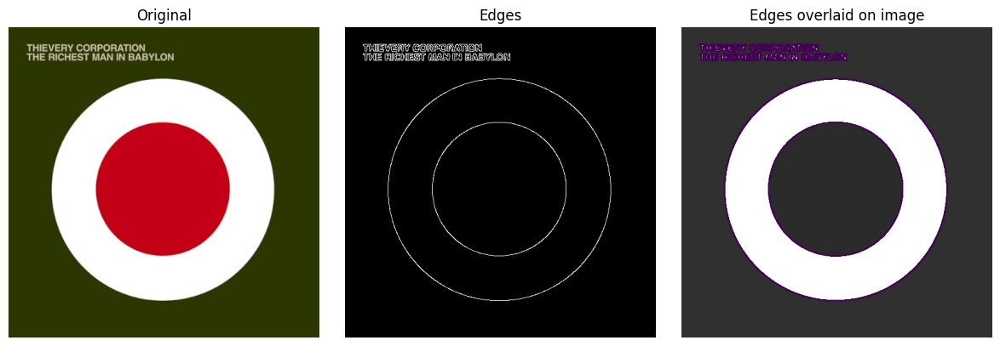

1766939079-large.jpg
edge_density: 0.016616
edge_orientation_entropy: 0.989944073147347


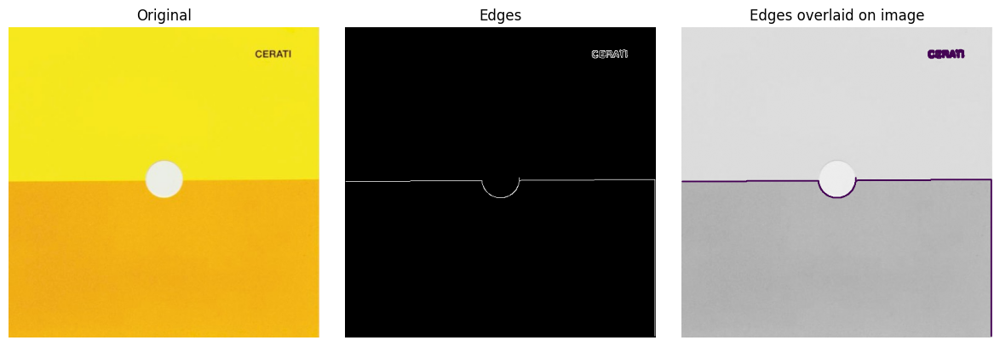

17519297659-px_500.jpg
edge_density: 0.004376
edge_orientation_entropy: 0.9169893620125902


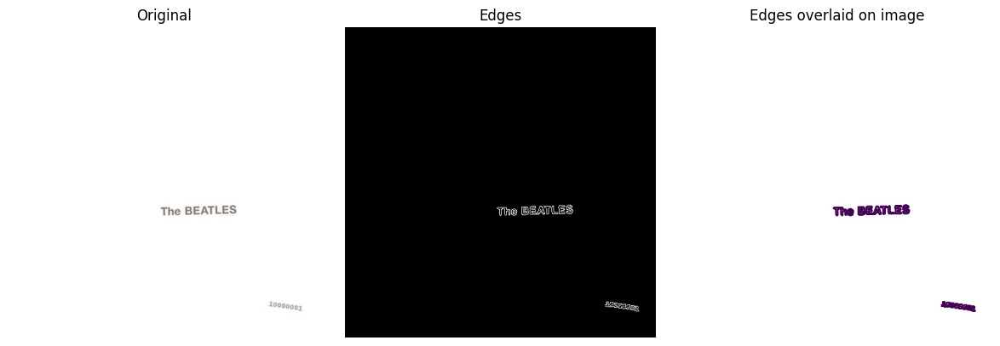

4924862361-large.jpg
edge_density: 0.003096
edge_orientation_entropy: 0.9409631840897117


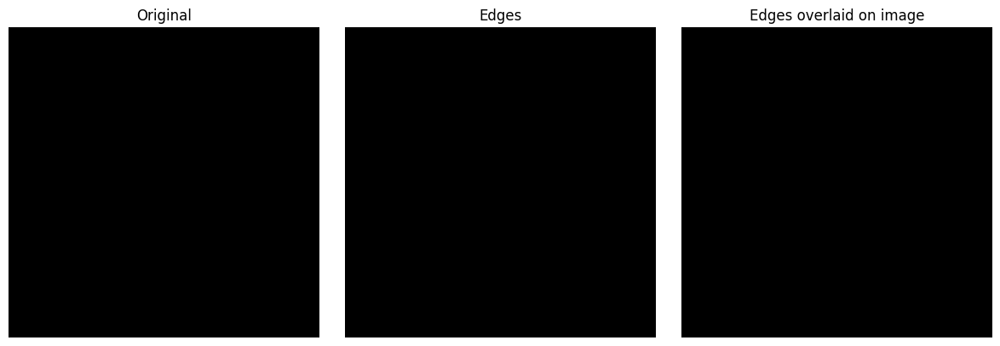

30944412549-px_500.jpg
edge_density: 0.0
edge_orientation_entropy: 0.0


In [8]:
from albcovis.utils.img import pil_to_numpy01, rgb_to_gray
from albcovis.services.texture_descriptors import compute_canny_edges, compute_sobel_gradients, edge_density, orientation_entropy_from_sobel

# Loop over some dev_set images to show our implementation of canny edge detector for this project

for filename in imgs_filenames:
    path = dir / filename
    img = Image.open(path)

    rgb01 = pil_to_numpy01(img)
    gray01 = rgb_to_gray(rgb01)

    # 2) Canny edges
    edges = compute_canny_edges(gray01, sigma=0.75)
    ed = edge_density(edges)

    # 3) Sobel orientation entropy
    gx, gy, mag = compute_sobel_gradients(gray01)
    oe = orientation_entropy_from_sobel(gx, gy, mag, nbins=18)

    # Show
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4))

    ax1.imshow(img)
    ax1.set_title("Original")
    ax1.axis("off")

    ax2.imshow(edges, cmap="gray", vmin=0, vmax=1)
    ax2.set_title("Edges")
    ax2.axis("off")

    ax3.imshow(gray01, cmap="gray", vmin=0, vmax=1)
    ax3.contour(edges, levels=[0.5], linewidths=0.8)
    ax3.set_title("Edges overlaid on image")
    ax3.axis("off")

    plt.tight_layout()
    plt.show()

    print(filename)
    print(f"edge_density: {ed}")
    print(f"edge_orientation_entropy: {oe}")


# Pixel intensity entropy

> ¿Porqué usar shannon entropy y no usar varianza o dev. estándar?

In [9]:
from albcovis.services.texture_descriptors import compute_entropy_gray

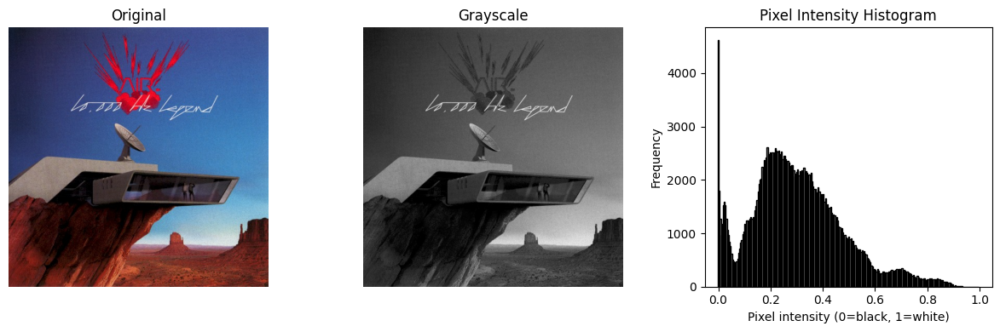

40654268451-px_500.jpg
entropy_val: 0.9225757963753831


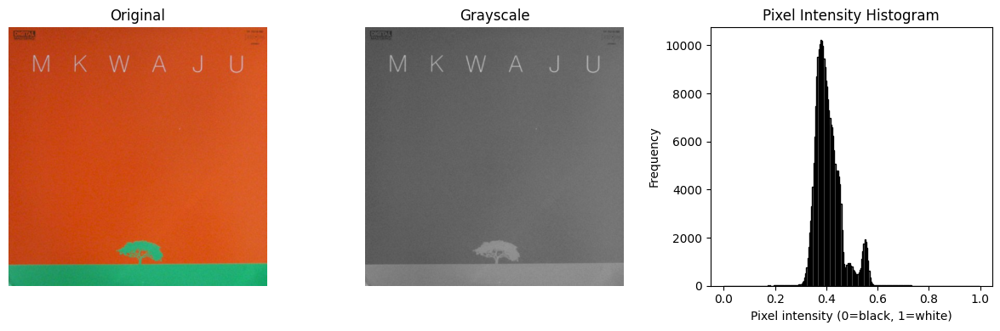

14688551481-large.jpg
entropy_val: 0.6941733702780352


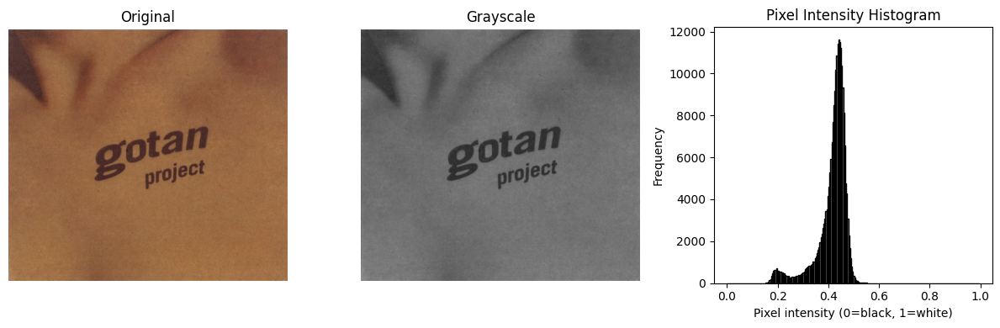

9845751214-large.jpg
entropy_val: 0.6881241928750881


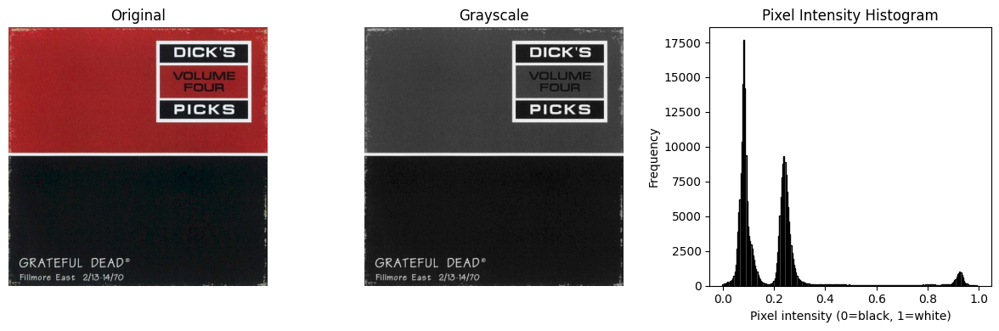

22280981189-px_500.jpg
entropy_val: 0.7275755849607602


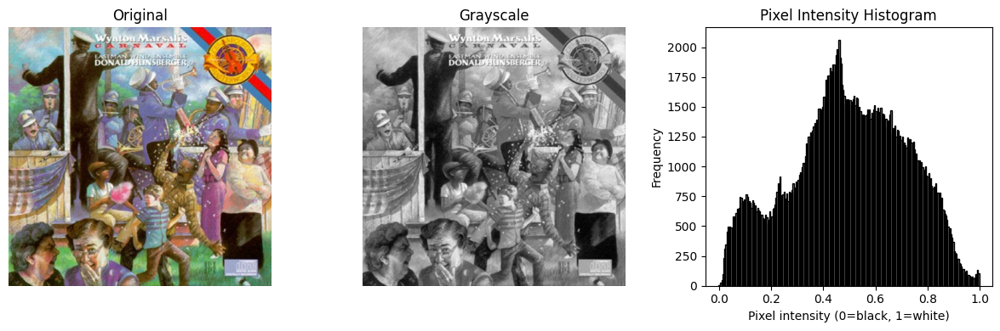

11446625684-large.jpg
entropy_val: 0.9718208705719185


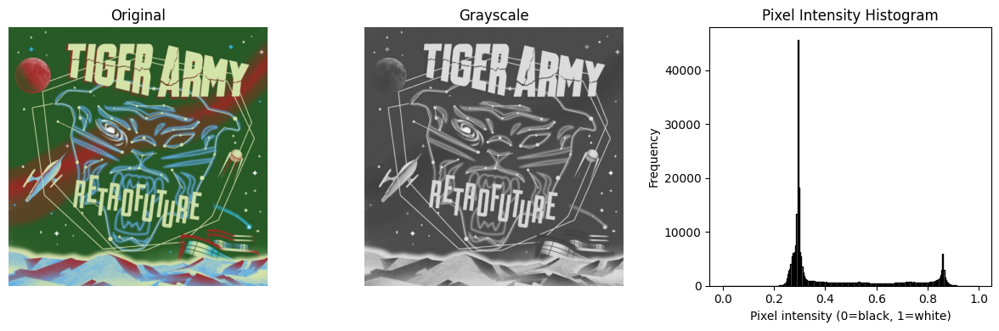

24818281700-px_500.jpg
entropy_val: 0.7502712481609275


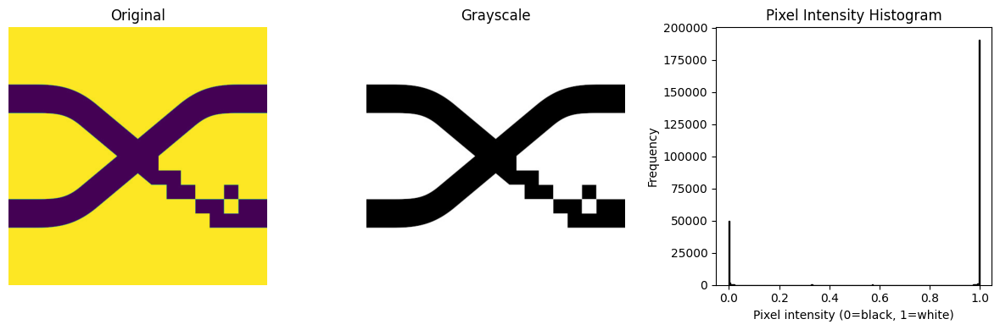

39341710398-px_500.jpg
entropy_val: 0.14206776013394273


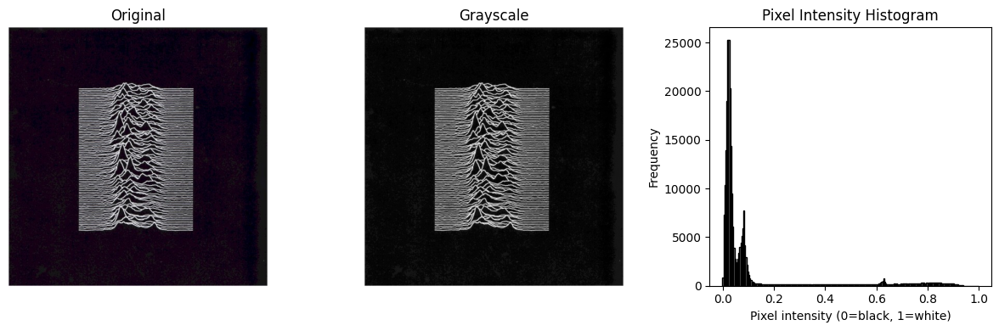

3880053972-px_500.jpg
entropy_val: 0.6784482082852522


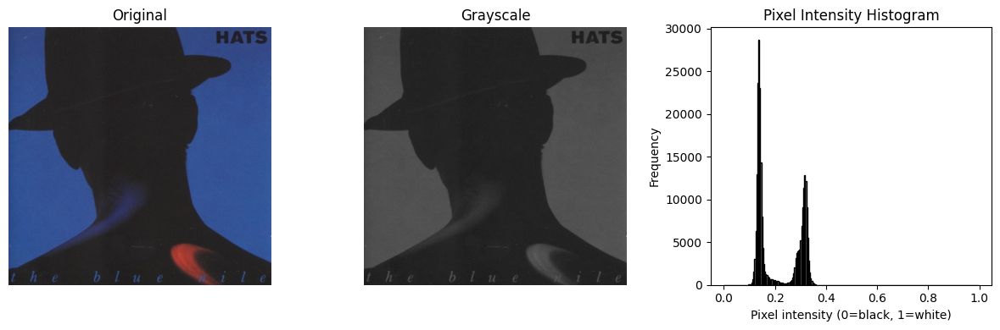

24961543145-px_500.jpg
entropy_val: 0.5978401733330039


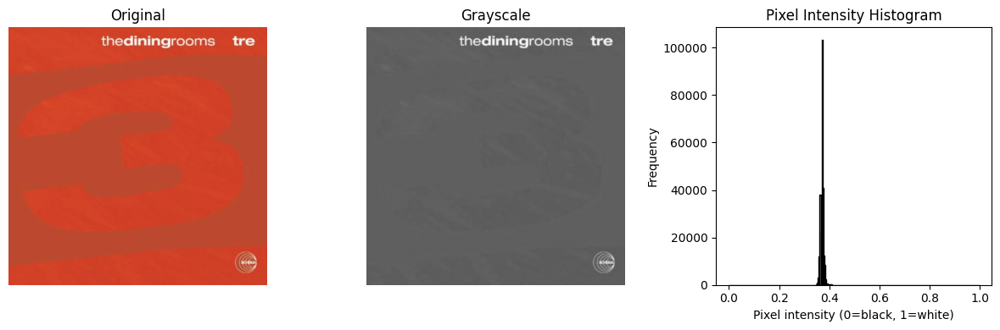

23776122656-px_500.jpg
entropy_val: 0.34279051450666465


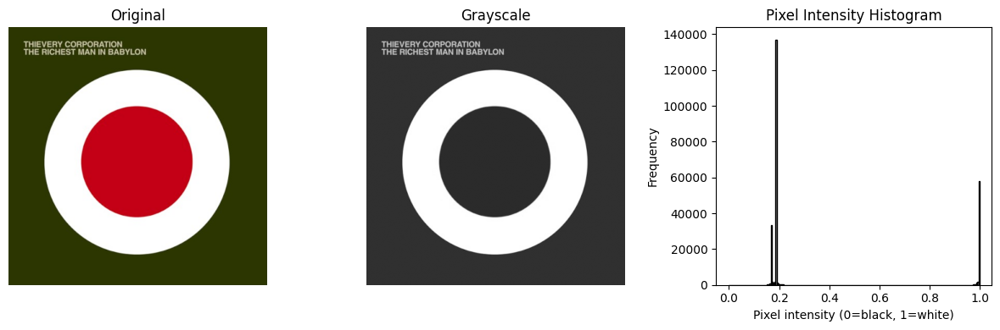

1766939079-large.jpg
entropy_val: 0.2734488706982613


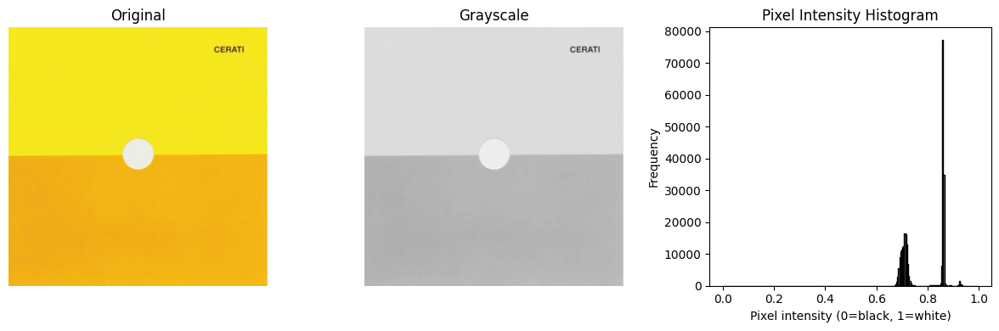

17519297659-px_500.jpg
entropy_val: 0.45396526519208685


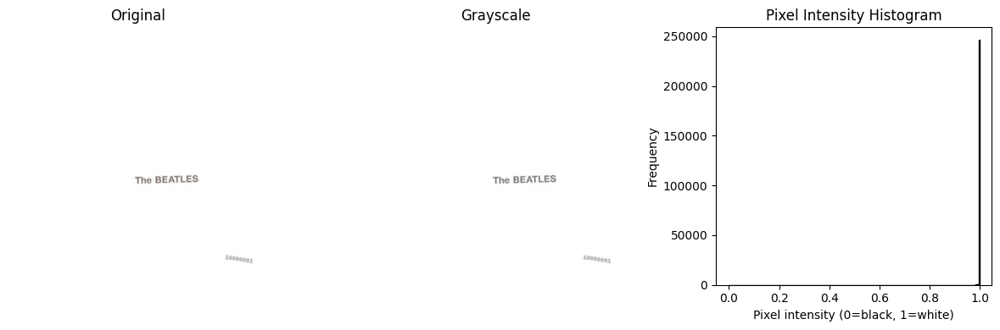

4924862361-large.jpg
entropy_val: 0.022223031464402798


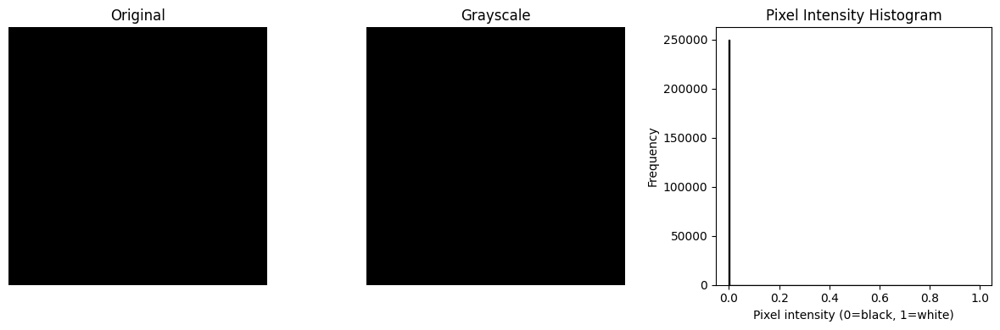

30944412549-px_500.jpg
entropy_val: -0.0


In [10]:
for filename in imgs_filenames:
    path = dir / filename
    img = Image.open(path)
    rgb01 = pil_to_numpy01(img)
    gray01 = rgb_to_gray(rgb01)
    nbins = 256
    entropy_val = compute_entropy_gray(gray01, nbins=nbins)
    hist, bin_edges = np.histogram(gray01, bins=nbins, range=(0.0, 1.0))

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4))

    ax1.imshow(img)
    ax1.set_title("Original")
    ax1.axis("off")

    ax2.imshow(gray01, cmap="gray", vmin=0, vmax=1)
    ax2.set_title("Grayscale")
    ax2.axis("off")
    
    ax3.bar(bin_edges[:-1], hist, width=1/256, color="gray", edgecolor="black")
    ax3.set_title("Pixel Intensity Histogram")
    ax3.set_xlabel("Pixel intensity (0=black, 1=white)")
    ax3.set_ylabel("Frequency")

    plt.tight_layout()
    plt.show()

    print(filename)
    print(f"entropy_val: {entropy_val}")

# GLCM Features (Haralick descriptors)

In [11]:
from albcovis.services.texture_descriptors import compute_glcm_features

In [12]:
filename = imgs_filenames[0]
path = dir / filename
img = Image.open(path)
rgb01 = pil_to_numpy01(img)
gray01 = rgb_to_gray(rgb01)
feats = compute_glcm_features(gray01)
feats

{'glcm_contrast': 3.897322224695626,
 'glcm_homogeneity': 0.6447839315339046,
 'glcm_energy': 0.12527574201878142,
 'glcm_correlation': 0.9393216327346616,
 'glcm_entropy': 4.685109078930604}

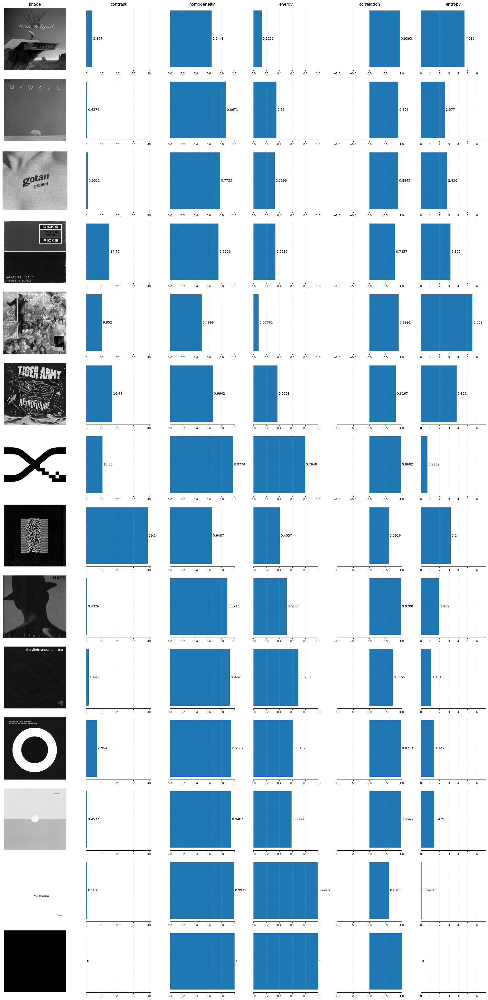

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image

desc_cols = ["glcm_contrast", "glcm_homogeneity", "glcm_energy", "glcm_correlation", "glcm_entropy"]

# Pass 1: compute features and keep display images
rows = []
for filename in imgs_filenames:
    path = dir / filename
    img = Image.open(path)

    # user-provided starting lines
    rgb01 = pil_to_numpy01(img)        # float image in [0,1], shape (H,W,3)
    gray01 = rgb_to_gray(rgb01)        # float image in [0,1], shape (H,W)

    feats = compute_glcm_features(gray01)
    rows.append({
        "filename": str(filename),
        "rgb01": rgb01,
        "gray01": gray01,
        **feats
    })

# Determine consistent x-limits per descriptor for fair visual comparison
xlims = {}
# sensible fixed ranges where known
xlims["glcm_homogeneity"] = (0.0, 1.0)
xlims["glcm_energy"]      = (0.0, 1.0)
xlims["glcm_correlation"] = (-1.0, 1.0)
xlims["glcm_entropy"] = (0.0, 2 * np.log(32))

# contrast can vary widely; use data-driven limits with a small margin
contrasts = np.array([r["glcm_contrast"] for r in rows]) if rows else np.array([0.0])
c_min, c_max = float(np.min(contrasts)), float(np.max(contrasts))
if c_min == c_max:
    c_min, c_max = max(0.0, c_min - 1e-6), c_max + 1e-6
pad = 0.05 * (c_max - c_min) if c_max > c_min else 0.01
xlims["glcm_contrast"] = (max(0.0, c_min - pad), c_max + pad)

# Plot: each row = image, then one small bar-plot per descriptor
n_rows = len(rows)
n_cols = 1 + len(desc_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(3.2 * n_cols, 2.8 * n_rows), squeeze=False)

# Column headers
axes[0, 0].set_title("Image", fontsize=11)
for j, d in enumerate(desc_cols, start=1):
    axes[0, j].set_title(d.replace("glcm_", ""), fontsize=11)

for i, r in enumerate(rows):
    # image cell
    ax_img = axes[i, 0]
    ax_img.imshow(np.clip(r["gray01"], 0, 1), cmap="gray")
    ax_img.set_axis_off()
    ax_img.set_xlabel(r["filename"], fontsize=9)

    # descriptor cells (draw a single horizontal bar and annotate the value)
    for j, d in enumerate(desc_cols, start=1):
        ax = axes[i, j]
        v = float(r[d])
        xmin, xmax = xlims[d]

        # barh with a single category at y=0
        ax.barh([0], [v], height=0.6)
        ax.set_xlim(xmin, xmax)
        ax.set_yticks([])
        # light grid and compact ticks
        ax.grid(True, axis='x', linestyle=':', alpha=0.4)
        ax.tick_params(axis='x', labelsize=8)
        # numeric label
        ax.text(v, 0, f" {v:.4g}", va='center', ha='left', fontsize=9)

        # tidy spines
        for spine in ["top", "right", "left"]:
            ax.spines[spine].set_visible(False)

# Overall layout
plt.tight_layout()
plt.show()


# Local Binary Patterns

In [14]:
from albcovis.services.texture_descriptors import compute_lbp_features

/home/sge/Documents/Sergio's OV [Debian]/Esade MiBA/TFM/albcovis-project/.venv/lib/python3.11/site-packages/skimage/feature/texture.py:385: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


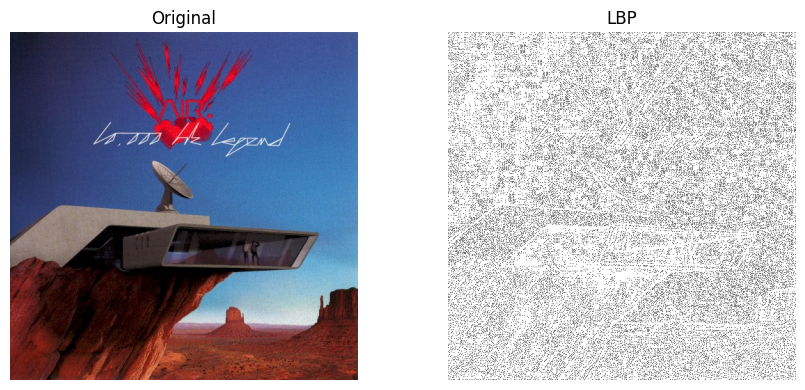

40654268451-px_500.jpg
{'lbp_entropy': 0.9374600881740883, 'lbp_energy': 0.130813962688}


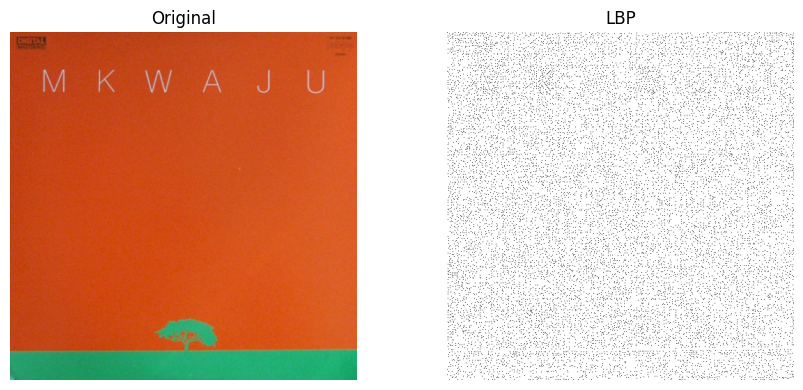

14688551481-large.jpg
{'lbp_entropy': 0.9823718045427462, 'lbp_energy': 0.10782808061160304}


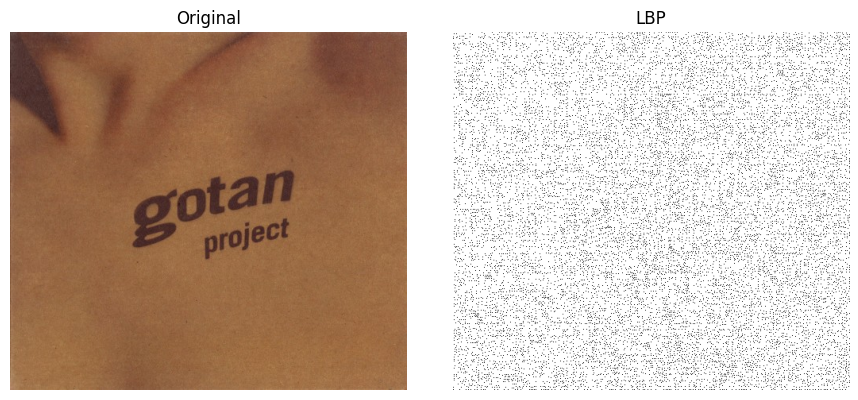

9845751214-large.jpg
{'lbp_entropy': 0.9837972416021223, 'lbp_energy': 0.10795819946746026}


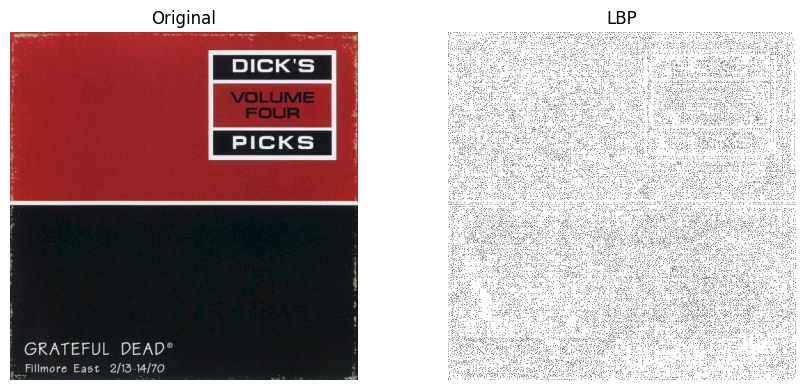

22280981189-px_500.jpg
{'lbp_entropy': 0.9732509135289471, 'lbp_energy': 0.113609657664}


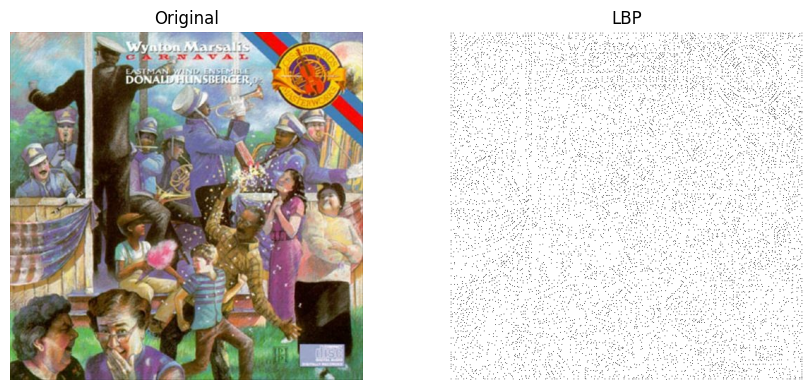

11446625684-large.jpg
{'lbp_entropy': 0.9172949332484284, 'lbp_energy': 0.14492563158869198}


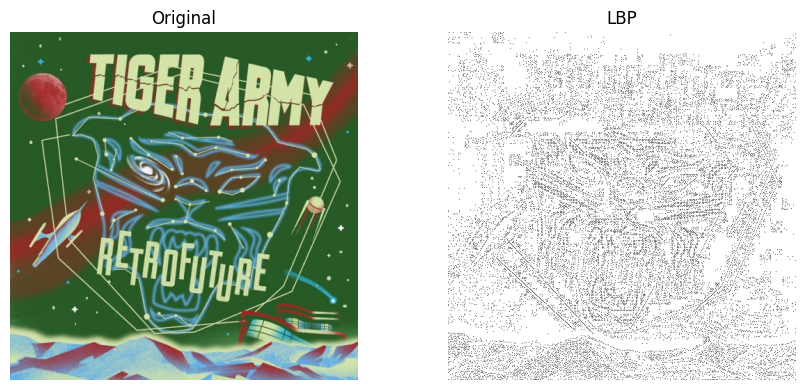

24818281700-px_500.jpg
{'lbp_entropy': 0.9547475919910838, 'lbp_energy': 0.12234223811199998}


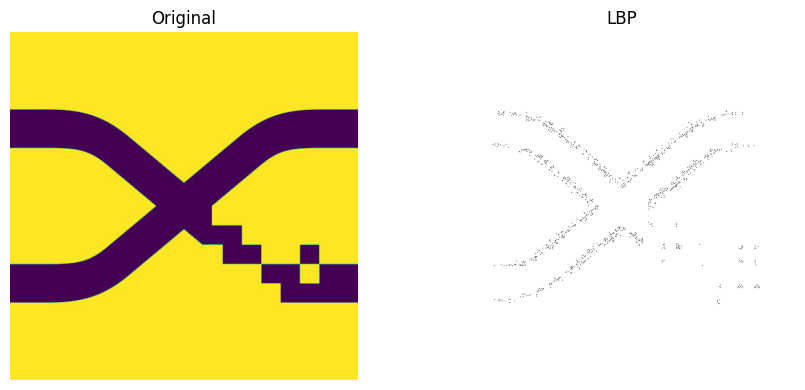

39341710398-px_500.jpg
{'lbp_entropy': 0.15528173663957484, 'lbp_energy': 0.8745001179840001}


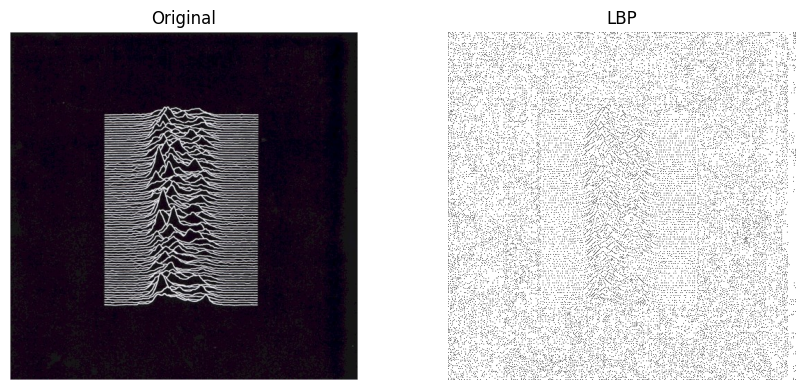

3880053972-px_500.jpg
{'lbp_entropy': 0.9753063903485917, 'lbp_energy': 0.11164676928}


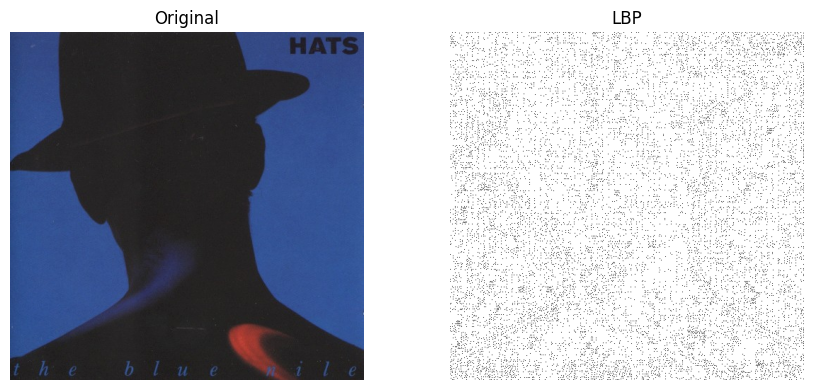

24961543145-px_500.jpg
{'lbp_entropy': 0.9676305587324175, 'lbp_energy': 0.11390129906140525}


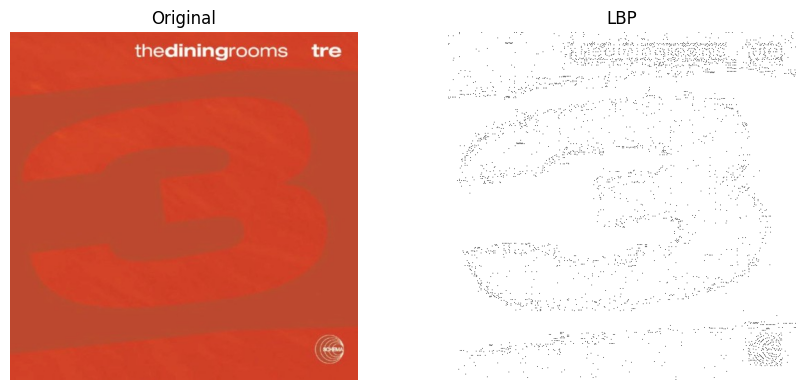

23776122656-px_500.jpg
{'lbp_entropy': 0.7040343129081454, 'lbp_energy': 0.31087350729600005}


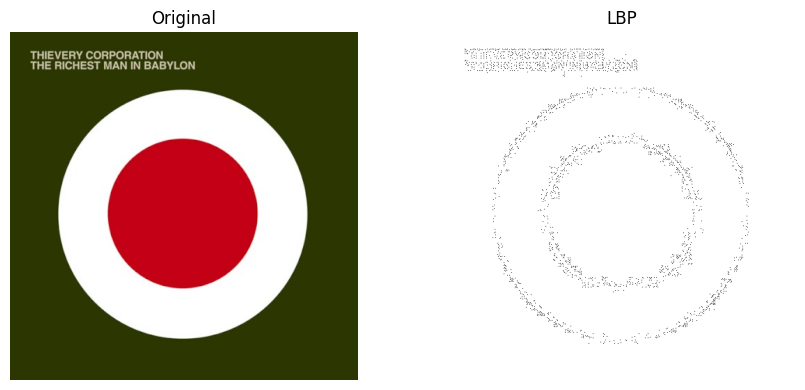

1766939079-large.jpg
{'lbp_entropy': 0.3438954238036635, 'lbp_energy': 0.6972656069119999}


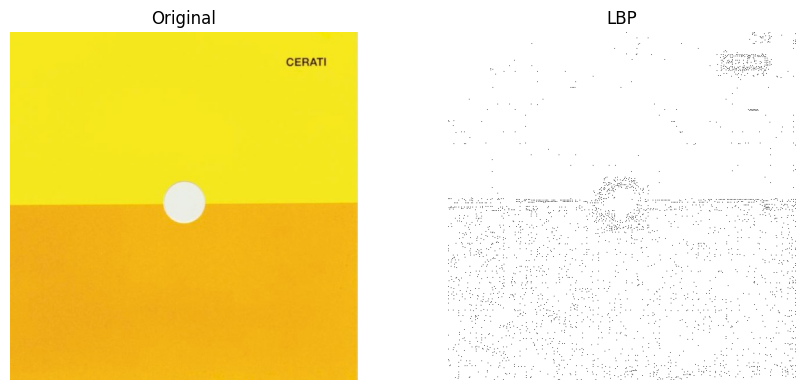

17519297659-px_500.jpg
{'lbp_entropy': 0.727155940798117, 'lbp_energy': 0.28970656864000005}


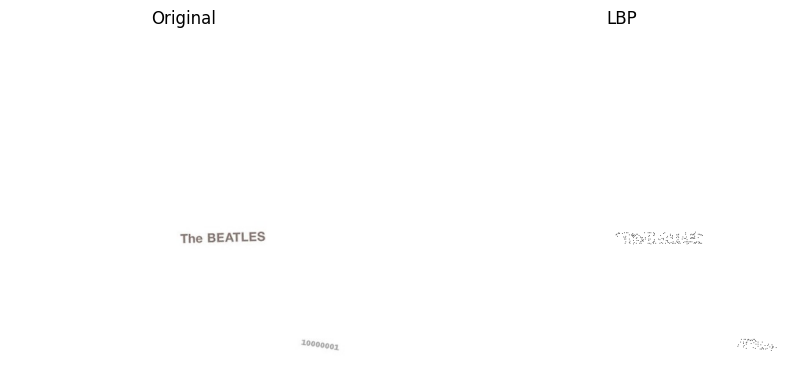

4924862361-large.jpg
{'lbp_entropy': 0.06991610380232459, 'lbp_energy': 0.9498014160960001}


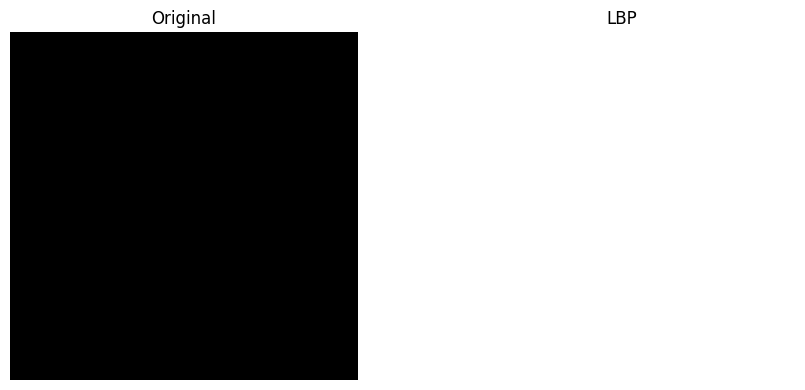

30944412549-px_500.jpg
{'lbp_entropy': -0.0, 'lbp_energy': 1.0}


In [15]:
for filename in imgs_filenames:
    path = dir / filename
    img = Image.open(path)
    rgb01 = pil_to_numpy01(img)
    gray01 = rgb_to_gray(rgb01)

    P = 8
    R = 1.0

    lbp = feature.local_binary_pattern(gray01, P=P, R=R, method="uniform")
    lbp_features = compute_lbp_features(gray01, P=P, R=R)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))

    ax1.imshow(img)
    ax1.set_title("Original")
    ax1.axis("off")

    ax2.imshow(lbp, cmap="gray", vmin=0, vmax=1)
    ax2.set_title("LBP")
    ax2.axis("off")

    plt.tight_layout()
    plt.show()

    print(filename)
    print(lbp_features)